In [4]:
import pandas as pd
import numpy as np
from scipy.optimize import fsolve
import matplotlib.pyplot as plt

# Inicialización de los parametros de las ondas usando la relación de dispersión.

In [5]:
#inicializacion de los parametros de las ondas, vamos a propagar n ondas
np.random.seed(1111)
n = 4
g = 9.8
H = np.linspace(0.5,3,30)
A = np.random.normal(loc = 1.5, scale = 0.6, size = n)
K = (2*np.pi)/np.linspace(0.5,6,n)

def create_dispersion(h,k):
  return lambda w: w**2 - (g*k*np.tanh(k*h))

W = []
for h_ in H:
  ws = []
  #print("profundidad", h_)
  for k_ in K:
    root = fsolve(create_dispersion(h_, k_), 0)
    ws.append(root[0])
    #print(" longitud de onda ", (1/k_)*(2*np.pi)," relacion h/l", h_*k_/(2*np.pi))
  ws = ws
  W.append(ws)
W = np.array(W)

# 1. Explicacion de los parametros de las ecuaciones
Tenemos las siguientes ecuaciones.

$$\eta(x,t) = acos(kx+wt)$$
$$L=(g/2)T^2tanh(kh)$$

Los parámetros son:

$a$ := Amplitud de la onda (es la distancia desde el nivel medio hasta la altura maxima que alcanza la onda)

$k$ := numero de onda ($2\pi/\lambda$ donde $\lambda$ es la longitud de onda) (mide en que distancia se completa una revolución de la onda si mantenemos el tiempo fijo)

$\omega$ := frecuencia angular ($2\pi/T$ donde $T$ es el periodo de la onda) (mide en cuanto tiempo se completa una revolución de la onda si mantenemos un punto del espacio fijo)

$h$ := Profundidad (distancia medida desde la superficie libre o nivel medio hasta el lecho del mar o hasta el fondo del fluido en donde se propaga la onda)

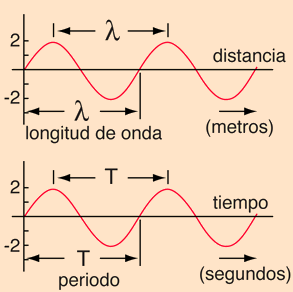

In [6]:
T = np.linspace(0,6,10000) #Tiempo
X = np.linspace(0,6,10000) #Espacio

# 2. Pintar varias ondas con variación de los parámetros a, T y h. Explicar k de que depende.


## Variación del numero de onda

Amplitud:  0.8562065786175542 Profundidad:  1.620689655172414


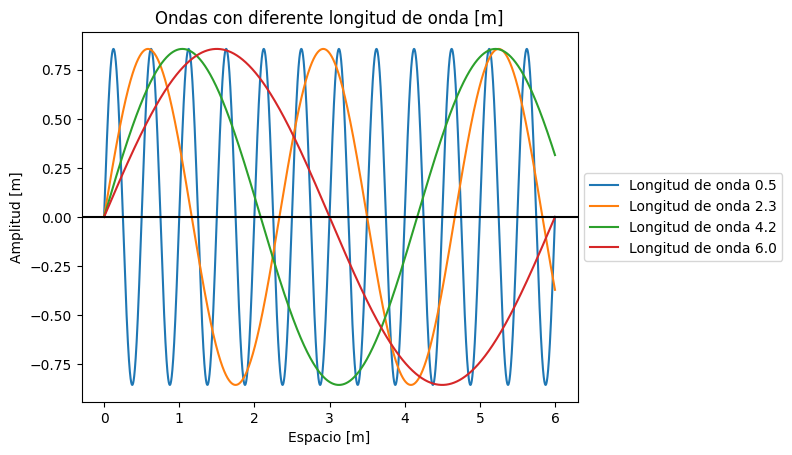

In [17]:
## fijamos la profundidad y amplitud variamos numero de onda, como queremos ver la variacion del numero de onda
## Para hacer la grafica mas simple, fijaremos un punto del tiempo para asi observar la variacion espacial
a = A[1] #amplitud
h = H[13] #profundidad
print("Amplitud: ",a ,"Profundidad: ",h)
for i in range(n):
  k = K[i]
  y = a*np.sin(k*X)
  plt.plot(X,y,label = f"Longitud de onda {round((1/K[i])*(2*np.pi),1)}")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("Espacio [m]")
plt.axhline(y=0, color='black', linestyle='-')
plt.title(f"Ondas con diferente longitud de onda [m]")
plt.ylabel("Amplitud [m]")
plt.show()

Los parametros fijos para las ondas son la amplitud y la profundidad (en metros):
$$a = 0.85$$
$$h = 1.62$$
Podemos observar que a medida que el numero de onda aumenta, se requiere mas distancia para que la onda complete un ciclo.

## Variacion de la amplitud

Numero de onda:  2.333333333333333 Profundidad:  1.620689655172414


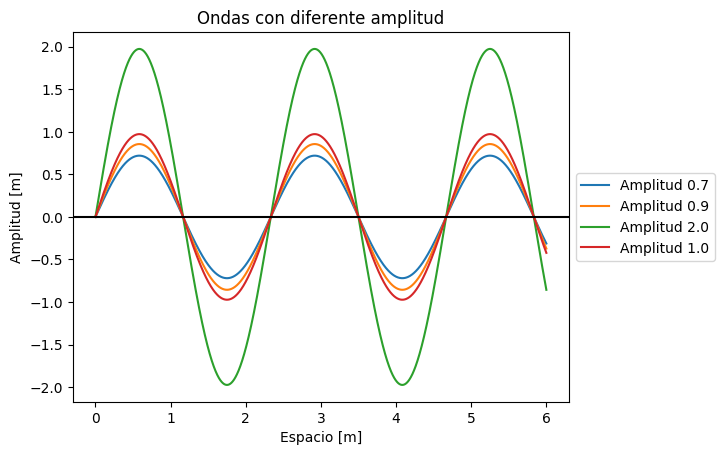

In [8]:
## fijamos la profundidad , numero de onda y variamos la amplitud para hacer la grafica
## mas simple, fijaremos un punto del tiempo para asi observar la variacion espacial
k = K[1] #numero de onda
h = H[13] #profundidad
print("Numero de onda: ",(1/k)*(2*np.pi) ,"Profundidad: ",h)
for i in range(n):
  a = A[i]
  y = a*np.sin(k*X)
  plt.plot(X,y,label = f"Amplitud {round(a,1)}")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("Espacio [m]")
plt.axhline(y=0, color='black', linestyle='-')
plt.title(f"Ondas con diferente amplitud")
plt.ylabel("Amplitud [m]")
plt.show()

Los parametros fijos para las ondas son el numero de onda y la profundidad:

$$\lambda = 2.33$$
$$h = 1.62$$

## Variacion de la profundidad

Amplitud:  0.8562065786175542 Numero de onda:  1.620689655172414


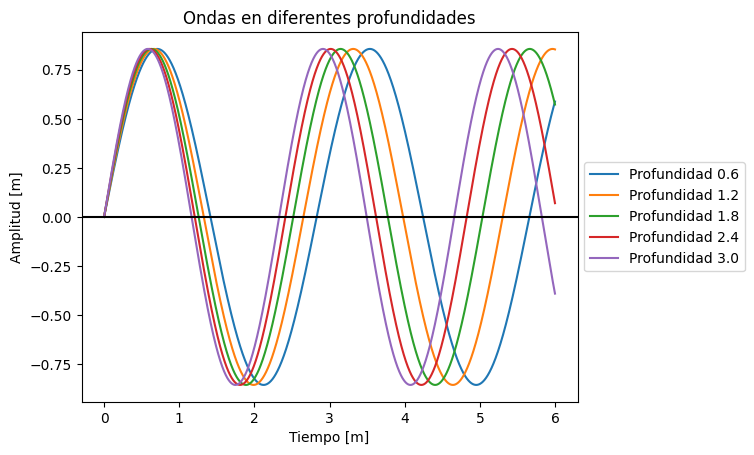

In [9]:
## fijamos la amplitud, numero de onda y variamos la profundiad para hacer la grafica
## como en este caso la profundidad tiene un efecto en la frecuencia, fijaremos un punto del espacio
## para asi observar la variacion temporal
a = A[1] #amplitud
k = K[1] #numero de onda
print("Amplitud: ",a ,"Numero de onda: ",h)
for h in H[1::7]:
  idx = np.where(H[1::7] == h)[0][0]
  w = W[idx, 3]
  y = a*np.sin(w*T)
  plt.plot(X,y,label = f"Profundidad {round(h,1)}")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("Tiempo [m]")
plt.axhline(y=0, color='black', linestyle='-')
plt.title(f"Ondas en diferentes profundidades")
plt.ylabel("Amplitud [m]")
plt.show()

Podemos observar en este caso que al fijar el numero de onda y la amplitud:

$$a = 0.85$$
$$\lambda = 1.62$$

la frecuencia angular se ve modificada por la variación en la profundidad, esto es debido a que las ondas que usé, caen en el rango de aguas intermedias, para asi poder ver el efecto de la profundidad en la frecuencia de las ondas.

El parametro k (numero de onda) depende de la profundidad y de la frecuencia de la onda, En el ultimo caso si mantenemos fijo el numero de onda, la profundidad modifica la frecuencia de la onda, hay una relacion entre estas 3 cantidades dada por la relacion de dispersion de la teoria lineal.



# 3. Pintar las ondas variando en el tiempo y variando en el espacio de manera independiente.

las ondas se ven de manera similar, si miramos las variaciones en el espacio y tiempo de manera independiente, la "tasa" de variación en cada una de las coordenadas viene dada por el numero de onda cuando miramos la variación espacial y por la frecuencia angular cuando miramos la variación temporal,

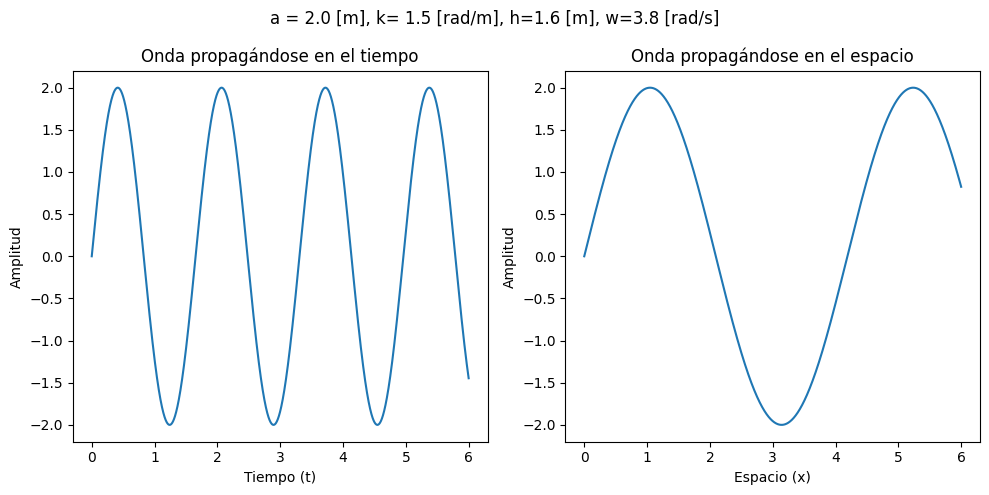

In [18]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (10,5))
# ax2.set_xlim(0, 6)
# ax2.set_ylim(-3, 3)
# ax1.set_xlim(0, 6)
# ax1.set_ylim(-2.5, 2.5)
ax2.set_xlabel('Espacio (x)')
ax2.set_ylabel('Amplitud')
ax2.set_title('Onda propagándose en el espacio')
ax1.set_xlabel('Tiempo (t)')
ax1.set_ylabel('Amplitud')
ax1.set_title('Onda propagándose en el tiempo')

a = round(A[2],1) #amplitud
k = round(K[2],1) #numero de onda
w = round(W[13, 2],1) #frecuencia
h= round(H[13],1) #profundidad

fig.suptitle(f'a = {a} [m], k= {k} [rad/m], h={h} [m], w={w} [rad/s]')

y1 = a*np.sin(w*T)
y2 = a*np.sin(k*X)
ax1.plot(T,y1,label = "")
ax2.plot(X,y2,label = "")
plt.tight_layout()
plt.show()

# 4. Pintar las ondas variando de manera conjunta en el tiempo y espacio.

## Primer tipo de visualización (no es la mejor en este caso)

In [19]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

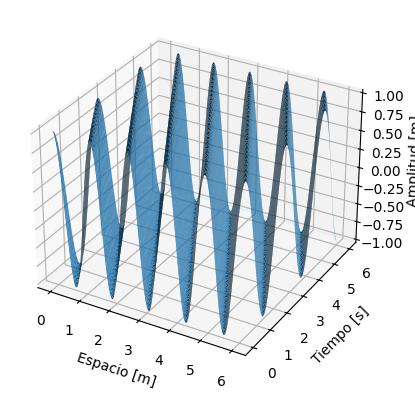

In [20]:
T_,X_ = np.meshgrid(T,X)
Z = np.cos(W[15][1]*np.ravel(X_) + K[1]*np.ravel(T_)).reshape(X_.shape)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X_, T_, Z)
ax.set_xlabel('Espacio [m]')
ax.set_ylabel('Tiempo [s]')
ax.set_zlabel('Amplitud [m]')
plt.show()

## Segundo tipo de visualización

In [21]:
# parametros de las ondas
a = A[1] #amplitud
k = K[3] #numero de onda
h = H[13] #profundidad
w = W[13, 3] #frecuencia

# Crear la figura y el eje
fig, ax = plt.subplots()
ax.set_xlim(0, 5)
ax.set_ylim(-1.5, 1.5)
ax.set_xlabel('Espacio (x)')
ax.set_ylabel('Amplitud')
ax.set_title('Onda propagándose en el espacio')
fig.suptitle(f'a = {round(a,1)} [m], k= {round(k,1)} [rad/m], h={round(h,1)} [m], w={round(w,1)} [rad/s]')

# Línea que se actualizará en la animación
line, = ax.plot([], [], lw=2)

# Función para inicializar la animación
def init():
    line.set_data([], [])
    return line,

# Función de actualización para cada cuadro de la animación
def update(t):
    y = a * np.sin(k*X + w*(t/100))
    line.set_data(X, y)
    return line,

# Crear la animación
frames = 300  # Número de cuadros en la animación
interval = 40  # Intervalo entre cuadros en milisegundos
ani = FuncAnimation(fig, update, frames=frames, init_func=init, blit=True, interval=interval)
plt.close()

In [22]:
# Mostrar la animación
html_animation = ani.to_jshtml()
HTML(html_animation)

# Superposicion de ondas
Vamos a superponer 3 ondas con las siguientes caracteristicas


In [23]:
# parametros de las ondas
h = H[13] #profundidad

a1 = A[1] #amplitud
k1 = K[1] #numero de onda
w1 = W[13, 1] #frecuencia

a2 = A[2] #amplitud
k2 = K[2] #numero de onda
w2 = W[13, 2] #frecuencia

a3 = A[3] #amplitud
k3 = K[3] #numero de onda
w3 = W[13, 3] #frecuencia

# Crear la figura y el eje
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (10,5))
ax2.set_xlim(0, 6)
ax2.set_ylim(-3.5, 3.5)
ax1.set_xlim(0, 6)
ax1.set_ylim(-2.5, 2.5)
ax2.set_xlabel('Espacio (x)')
ax2.set_ylabel('Amplitud')
ax2.set_title('Onda propagándose en el espacio')

# Línea que se actualizará en la animación
line, = ax2.plot([], [], lw=2)
line1, = ax1.plot([], [], lw=2)
line2, = ax1.plot([], [], lw=2)
line3, = ax1.plot([], [], lw=2)

# Función para inicializar la animación
def init():
    line.set_data([], [])
    line1.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    return line,

# Función de actualización para cada cuadro de la animación
def update(t):
    y1 = a1 * np.sin(k1*X + w1*(t/100))
    y2 = a2 * np.sin(k2*X + w2*(t/100))
    y3 = a3 * np.sin(k3*X + w3*(t/100))
    line.set_data(X, y1 + y2 + y3)
    line1.set_data(X, y1)
    line2.set_data(X, y2)
    line3.set_data(X, y3)

    return line,line1,line2,line3,

# Crear la animación
frames = 300  # Número de cuadros en la animación
interval = 40  # Intervalo entre cuadros en milisegundos
ani = FuncAnimation(fig, update, frames=frames, init_func=init, blit=True, interval=interval)
plt.close()

In [24]:
# Mostrar la animación
html_animation = ani.to_jshtml()
HTML(html_animation)

# Segunda parte

## Explicar qué técnicas de medición de campo hay para las olas y en qué principios se basa cada una. Complementar con gráficos, esquemas, etc…

#Boyas de Oleaje

Las boyas de oleaje son instrumentos diseñados para medir el movimiento de las olas del océano siguiendo de cerca el movimiento de las partículas de agua en la superficie del mar. Principalmente miden la aceleración vertical utilizando un acelerómetro a bordo, complementado con horizontes artificiales, para derivar la elevación de la superficie del mar.

**Tipos de boyas de oleaje:**

1. **Boya de elevacion**

* Miden el movimiento vertical (oleaje), pero pueden distorsionar los perfiles de las olas debido al movimiento horizontal y las características de la boya.

* Los modelos más comunes incluyen:

  * Boyas NDBC (EE. UU.): Más grandes, con diámetros de hasta 10 m.
  * Boyas WAVERIDER (Datawell, Países Bajos): Más pequeñas, < 1 m de diámetro.

2. **Boyas direccionales:**

* Proporcionan información sobre la dirección de las olas y la cresta corta.
* Los tipos incluyen:
  * **Boyas de detección de pendiente:** miden el movimiento de cabeceo y balanceo con sensores de inclinómetro (por ejemplo, boyas WAVEC).
  * **Boyas de movimiento horizontal:** detectan el oleaje y el balanceo mediante el campo magnético de la Tierra o el GPS (p. ej., el DIRECCIONAL WAVERIDER, la boya SMART).

3. **Boyas avanzadas:**

* **Boyas de hoja de trébol:**

  Miden la elevación, la pendiente y la curvatura mediante tres sensores de cabeceo y balanceo montados en un marco. Se utilizan en estudios científicos especializados.
  
**Comunicación y avances:**
Las boyas modernas utilizan GPS y comunicación satelital para lograr un posicionamiento y una transmisión de datos precisos.
Las mejoras del GPS, como el GPS diferencial (D-GPS), mejoran la precisión de la medición de las olas al detectar los cambios Doppler en las señales satelitales.

**Limitaciones y correcciones:**
Las boyas pueden subestimar las olas cortas, resonar en frecuencias naturales y evitar crestas de olas pronunciadas debido a su forma y tamaño.
Estas distorsiones suelen corregirse durante el análisis de datos para mejorar la precisión.

A pesar de sus limitaciones, las boyas de olas son herramientas confiables para los estudios de olas oceanográficas, que ofrecen datos valiosos para fines de investigación y operativos.

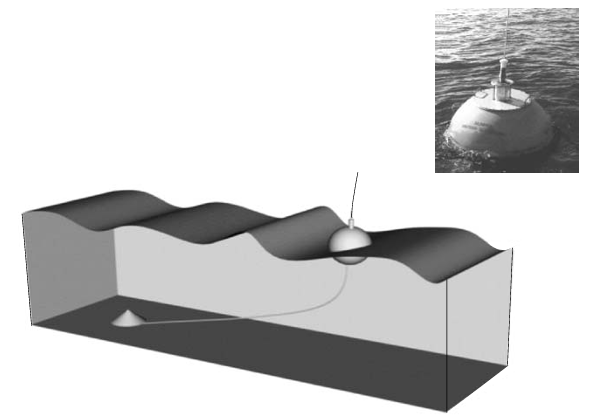

# Varas de olas

Los postes de olas (o varas de olas) son instrumentos que se utilizan para medir la posición vertical de la superficie del agua en relación con un cable o una serie de cables suspendidos de una plataforma marina. Estas mediciones se basan en cambios en las propiedades del cable o en las reflexiones de la señal.

**Técnicas de medición:**

1. **Cable único:**

* Mide la parte seca del cable detectando cambios en la resistencia eléctrica.
* Alternativamente, mide la capacitancia eléctrica de cables o cordones aislados.
* Las señales de alta frecuencia también pueden detectar la superficie del agua a través de la reflexión de la señal.

2. **Conjuntos de cables:**

* **Conjunto de pendiente:** una pequeña disposición triangular de tres postes estima la pendiente de las olas analizando la inclinación de la superficie.
* **Conjunto de fase:** una configuración triangular más grande detecta las diferencias de fase entre los postes, lo que determina la dirección de las olas. Un tercer poste resuelve la ambigüedad de 180°.

**Limitaciones:**
Las películas delgadas de agua sobre el cable pueden crear errores, especialmente en mares agitados, pero estos son generalmente pequeños y manejables. Al igual que las boyas de elevación, los postes de olas individuales carecen de información direccional sobre las olas a menos que se dispongan en matrices.

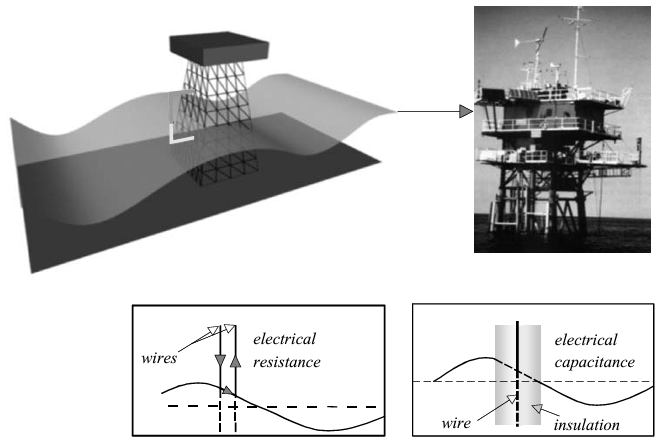

# Transductores de presión

Un transductor de presión, ubicado a cierta profundidad debajo de la superficie del mar, puede medir las fluctuaciones de presión inducidas por las olas. Estas fluctuaciones, combinadas con la teoría de las olas lineales, pueden utilizarse para estimar las características de las olas. debe tener una presicion en segundos menor al periodo de la onda que se quiera analizar o registrar para asi poder capturar las variaciones de estas. estos instrumentos proveen informacion escalar de la amplitud de la onda en el tiempo, en principo no es informacion direccional pero cuando se despliegan en un patrón espacial, un conjunto de (al menos tres) transductores de presión pueden proporcionar información direccional sobre las ondas.

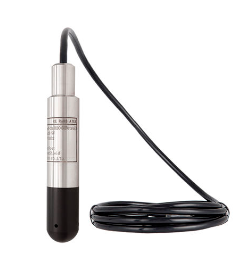

# Ecosonda

La ecosonda invertida es un instrumento situado a cierta profundidad bajo la superficie del mar, que mide la posición de la superficie del agua con un haz sónico estrecho que mira hacia arriba. Funciona emitiendo señales acústicas hacia arriba desde el fondo marino y midiendo el tiempo que tarda el eco en regresar tras reflejarse en la superficie del agua. funciona utilizando el principio dopler del sonido viajando en un medio como el agua

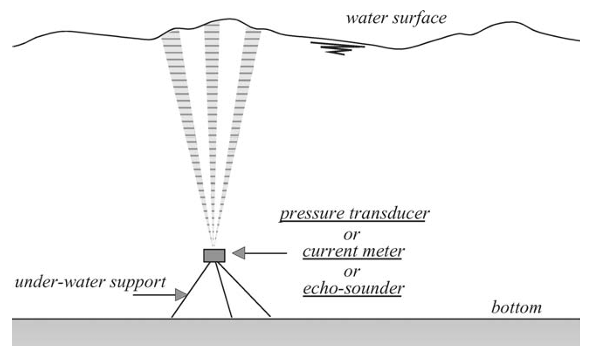

# Sensores remotos

Los instrumentos de teledetección se montan en plataformas sobre la superficie del agua, como torres de observación, barcos, aviones, satélites o incluso estaciones terrestres. Estos instrumentos miden las propiedades de las olas analizando los reflejos de la superficie del mar utilizando luz visible, radiación infrarroja o energía de radar.

**Características principales:**

* **Amplia cobertura:** la teledetección puede estudiar grandes áreas casi instantáneamente, especialmente cuando se utilizan satélites.
* **Costos pero costos compartidos:** si bien la teledetección suele ser experimental y más costosa que las técnicas in situ, los gobiernos y las organizaciones internacionales con frecuencia subsidian estos esfuerzos, haciéndolos accesibles a los usuarios individuales.

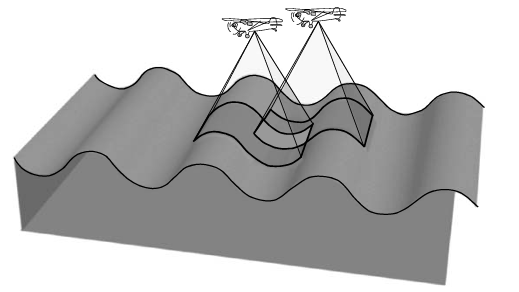